## Problem Statement and Motivation
Asteroids are classified into three main categories (C, S, and  M). We are interested in the M-type (metallic) asteroids. Manually classifying asteroids can be a slow and tedious process due to the number of observations we need to gather sufficient data. The goal of this project is to predict if asteroids are metallic using data that is faster and easier to gather. We can imagine a future where humans are mining asteroids for resources. A model such as this could be used to speed up the process of searching for metallic asteroids. This could also be used to help identify the most profitable asteroids in the early stages of asteroid mining.

## Imports and Setup

In [1]:
import numpy as np
import pandas as pd
import pandas_profiling
import math

import requests
import json

import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder

from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier

from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline

from sklearn.model_selection import cross_val_predict
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc

Dataset: https://www.kaggle.com/basu369victor/prediction-of-asteroid-diameter

In [2]:
asteroids = pd.read_csv("~/data/Asteroid_Updated.csv")

C:\Users\mitch\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3166: DtypeWarning: Columns (0,10,15,16,23,24) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


### Description of Dataset Columns
* full_name: Object full name/designation
* a: semi-major axis(au)
* e: eccentricity
* G: Magnitude slope parameter
* i: Inclination with respect to x-y ecliptic plane(deg)
* om: Longitude of the ascending node
* w: argument of perihelion
* q: perihelion distance(au)
* ad: aphelion distance(au)
* per_y: Orbital period
* data_arc: data arc-span(d)
* condition_code: Orbit condition code
* n_obs_used: number of observations used
* H: Absolute Magnitude parameter
* diameter: Diameter of asteroid(Km)
* extent: Object bi/tri axial ellipsoid dimensions(Km)
* albedo: geometric albedo
* rot_per: Rotation Period(h)
* GM: Standard gravitational parameter, Product of mass and gravitational constant
* BV: Color index B-V magnitude difference
* UB: Color index U-B magnitude difference
* IR: Color index I-R magnitude difference
* spec_B: Spectral taxonomic type(SMASSII)
* spec_T: Spectral taxonomic type(Tholen)
* neo: Near Earth Object
* pha: Physically Hazardous Asteroid
* moid: Earth Minimum orbit Intersection Distance(au)

## Preliminary Exploration of Asteroids Dataset

In [3]:
# This generates a summary of the dataset detailing distributions, correlations, missing values, summary statistics, etc.
# This report might not show up in GitHub
pandas_profiling.ProfileReport(asteroids, minimal = False)

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data Cleaning and Preprocessing

In [4]:
# Need 'spec_B' and 'spec_T' to determine if an asteroid is metallic
cleaned_asteroids = asteroids[~asteroids['spec_B'].isna() | ~asteroids['spec_T'].isna()]

# Remove unwanted data
cleaned_asteroids.drop(['name', 'extent', 'GM', 'IR', 'G', 'neo', 'pha', 'condition_code', 'class'], axis = 1, inplace = True)

# drop due to high correlation with other features
cleaned_asteroids.drop(['a', 'per', 'per_y', 'moid'], axis = 1, inplace = True)

# not useful for model
cleaned_asteroids.drop(['n_obs_used', 'ma'], axis = 1, inplace = True)

# Convert 'diameter' from class to numeric data type
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'diameter':'float64'}, copy=True, errors='raise')

# This is useful for visualizing features later
for_feature_viz = cleaned_asteroids.drop(['spec_B', 'spec_T'], axis = 1)

# Since we're predicting if the asteroid is 'metallic', we probably won't have these values
cleaned_asteroids.drop(['BV', 'UB'], axis = 1, inplace = True)

C:\Users\mitch\Anaconda3\lib\site-packages\pandas\core\frame.py:4315: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [5]:
# Remove bad observation
cleaned_asteroids = cleaned_asteroids.drop(541682, axis = 0)

In [6]:
# Determine which observations are metallic based on spec_B and spec_T

cleaned_asteroids['spec_B'].replace({'Xk':'1', 'Xc':'1', 'Xe':'1', 'X:':'1'}, inplace = True)
cleaned_asteroids.loc[:,'spec_B'].iloc[cleaned_asteroids['spec_B'] != '1'] = '0'
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'spec_B':'int32'}, copy=True, errors='raise')

cleaned_asteroids['spec_T'].replace({'E':'1', 'M':'1', 'X':'1', 'X:':'1', 'XC':'1', 'XC:':'1', 'XD':'1', 'XD:':'1'}, inplace = True)
cleaned_asteroids.loc[:,'spec_T'].iloc[cleaned_asteroids['spec_T'] != '1'] = '0'
cleaned_asteroids = cleaned_asteroids.astype(dtype = {'spec_T':'int32'}, copy=True, errors='raise')

cleaned_asteroids.loc[:,'metallic'] = (cleaned_asteroids['spec_B'] + cleaned_asteroids['spec_T'] > 0)*1
cleaned_asteroids = cleaned_asteroids.drop(['spec_T', 'spec_B'], axis = 1) # no longer needed

C:\Users\mitch\Anaconda3\lib\site-packages\pandas\core\indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [7]:
# Train test split
asteroids_train, asteroids_test = train_test_split(cleaned_asteroids, test_size=0.4, random_state = 0)

## Post Cleaning Inspection

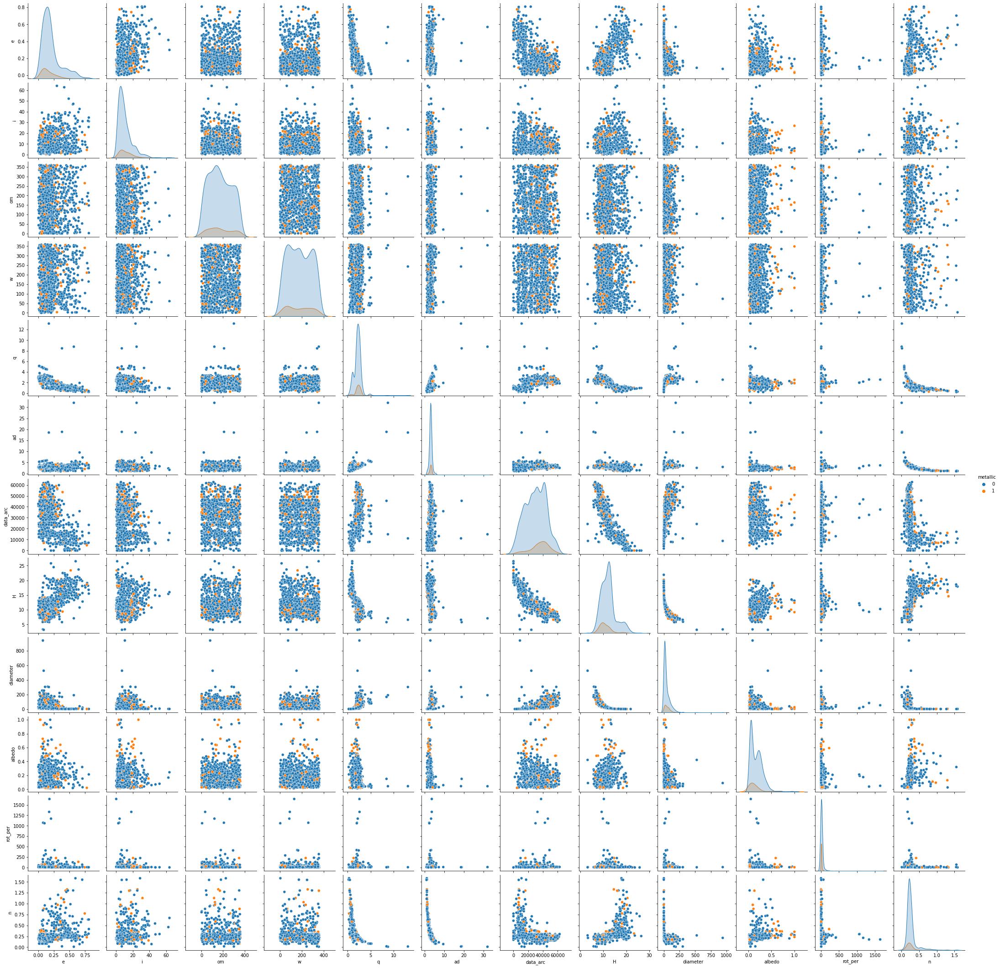

In [8]:
sns.pairplot(asteroids_train, kind = 'scatter', hue = 'metallic')

Upon inspecting the pair plot, we can see that there is a lot of overlap between the metallic and non-metallic asteroids. We can't be sure yet, but it looks like ensemble techniques might be the best considering our smaller data set.
<br/><br/>

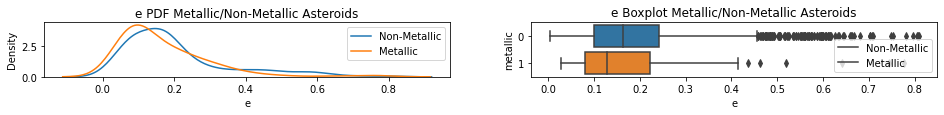

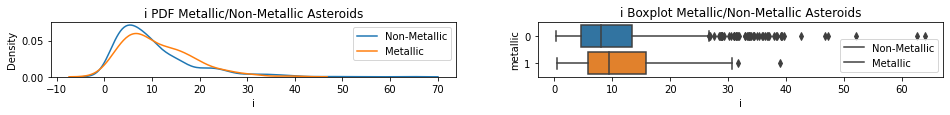

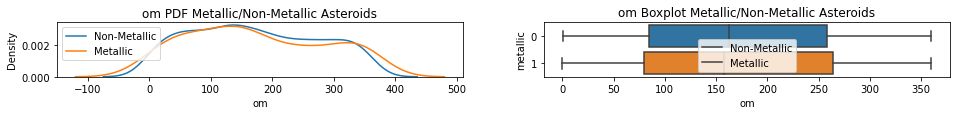

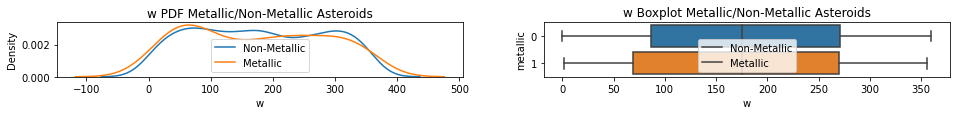

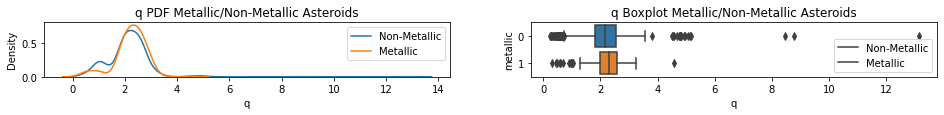

...

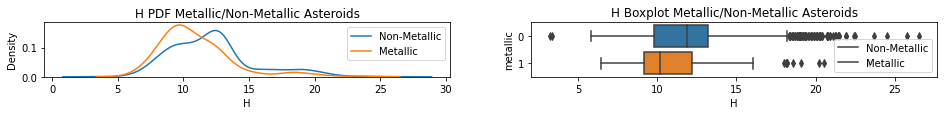

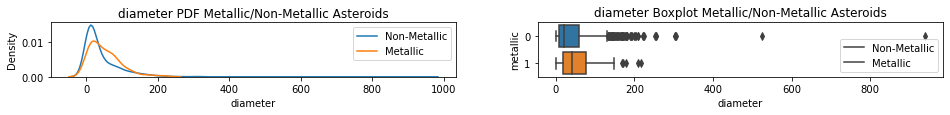

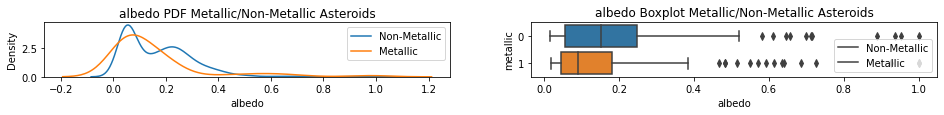

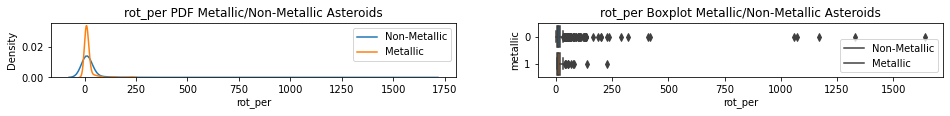

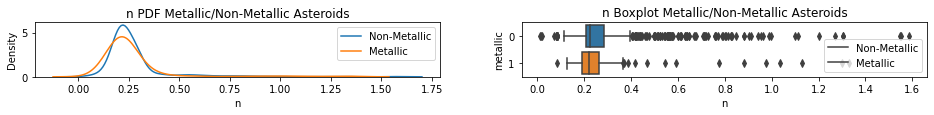

In [9]:
for col_name in asteroids_train.drop('metallic', axis = 1).columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 1))
    sns.kdeplot(x = asteroids_train[asteroids_train['metallic'] == 0][col_name], ax=ax1)
    sns.kdeplot(x = asteroids_train[asteroids_train['metallic'] == 1][col_name], ax=ax1)
    ax1.legend(['Non-Metallic', 'Metallic'])
    ax1.set_title(col_name + ' PDF Metallic/Non-Metallic Asteroids')
    
    sns.boxplot(x = col_name, y = 'metallic', data = asteroids_train, orient = 'h', ax=ax2)
    ax2.legend(['Non-Metallic', 'Metallic'])
    ax2.set_title(col_name + ' Boxplot Metallic/Non-Metallic Asteroids')

Looking at the plots above it looks 'data_arc', 'H', 'diameter', 'albedo', and maybe 'rot_per' would be decent features on their own. Some other features like 'i' and 'e' might end up being useful after some feature engineering. Features like 'om', 'q', 'w', and 'ad' look much less promising, so we will probably drop them. 
<br/>

## Feature Engineering and Pipeline Function

In [10]:
X_train, y_train = asteroids_train.drop('metallic', axis=1), asteroids_train['metallic']

X_train = X_train.reset_index().drop('index', axis=1)
y_train = pd.DataFrame(y_train).reset_index().drop('index', axis=1)['metallic']

In [11]:
# Preliminaries for Feature Engineering and Pipeline 
imputer = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer.fit(X_train)

ss = StandardScaler(copy = False)

# after some feature selection, these features on their own are no longer useful
drop_original = ['ad', 'w', 'e', 'om', 'q', 'diameter', 'n', 'albedo']

### Potential Feature Visualization
I used the autofeat library to generate a list of potentially useful features for my model.

In [12]:
# # List of Considered Features
def viz_considered_features(X):
    X_copy = X.copy()
    
    imputer.transform(X_copy)
    
    X_copy['ad**2/i'] = X_copy['ad']**2/X_copy['i']
    X_copy['n**2*log(n)'] = X_copy['n']**2*np.log(X_copy['n'])
    X_copy['n*q'] = X_copy['n']*X_copy['q']
    X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
    X_copy['Abs(albedo - sqrt(e))'] = abs(X_copy['albedo'] - np.sqrt(X_copy['e']))
    X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
    X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
    X_copy['1/(log(albedo) + 1/H)'] = 1/(np.log(X_copy['albedo']) + 1/X_copy['H'])
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
    X_copy['e*exp(-i)'] = X_copy['e']*np.exp(-X_copy['i'])
    X_copy['1/(exp(q) - log(w))'] = 1/(np.exp(X_copy['q']) - np.log(X_copy['w']))
    X_copy['1/(diameter**2 + w)'] = 1/(X_copy['diameter']**2 + X_copy['w'])
    X_copy['1/(diameter**3 - om**3)'] = 1/(X_copy['diameter']**3 - X_copy['om']**3)
    X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
    X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['(q**2 - log(data_arc))**2'] = (X_copy['q']**2 - np.log(X_copy['data_arc']))**2
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))

    X_copy['exp(-q) / n**3'] = np.exp(-X_copy['q']) / (X_copy['n'])**3
    X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
    X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
    X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
    X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
    X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    
    i = 8
    while i < len(X_copy.columns) + 8:
        X_slice = X_copy.iloc[:, i-8 : min(i, len(X_copy)-2)]
        sns.pairplot(
            data = pd.concat([ X_slice, for_feature_viz[['BV', 'UB']] ], axis = 1),
            x_vars = X_slice.columns,
            y_vars = ['BV', 'UB'],
            kind = 'reg',
            plot_kws = {'ci':None, 'marker':'.'}
        )
        i += 8
    
    return X_copy

<br/>
The 'BV' and 'UB' variables are good predictors of metallic asteroids but are time-consuming to measure. The idea with the plots below is that if a feature is a good predictor of either 'BV' or 'UB', then it's probably a good predictor of metallic asteroids.

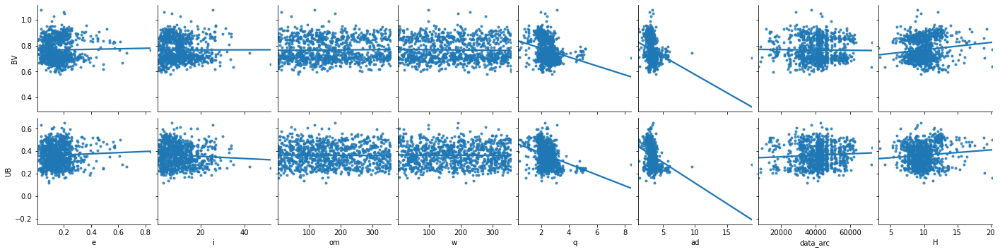

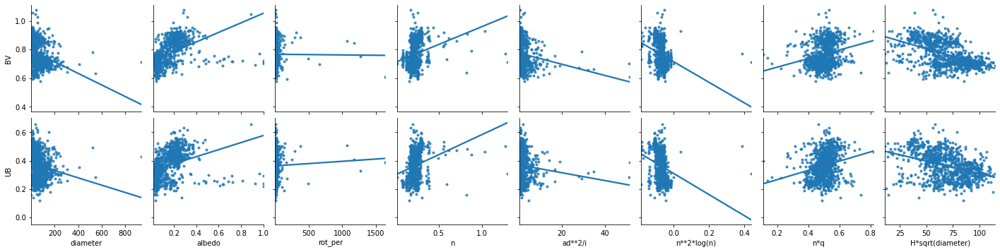

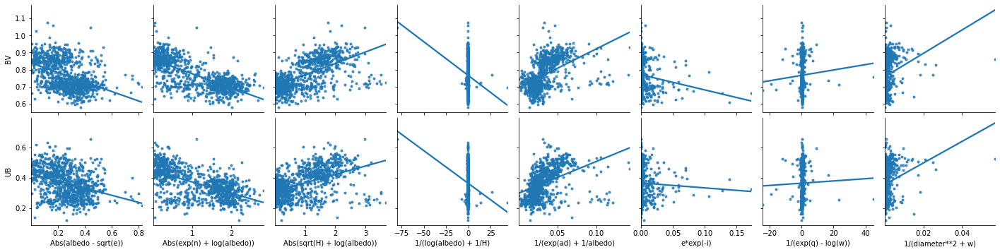

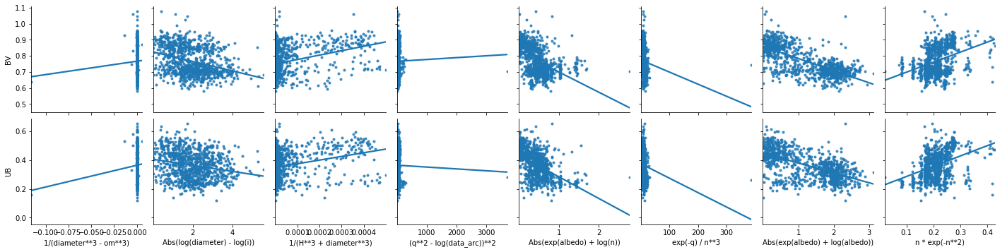

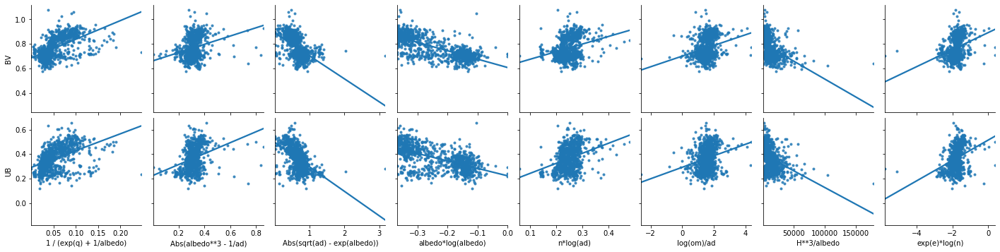

In [13]:
considered_features = viz_considered_features(for_feature_viz.drop(['BV', 'UB'], axis = 1))

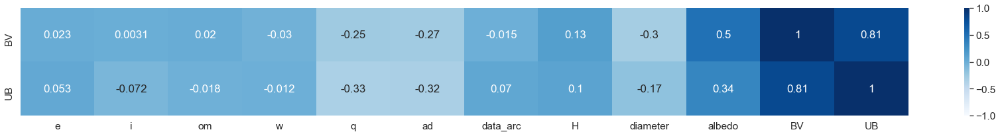

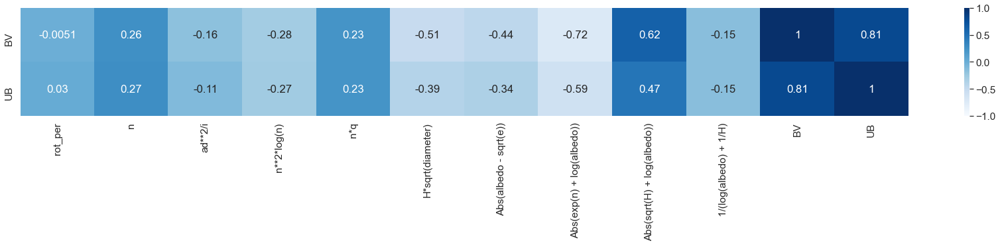

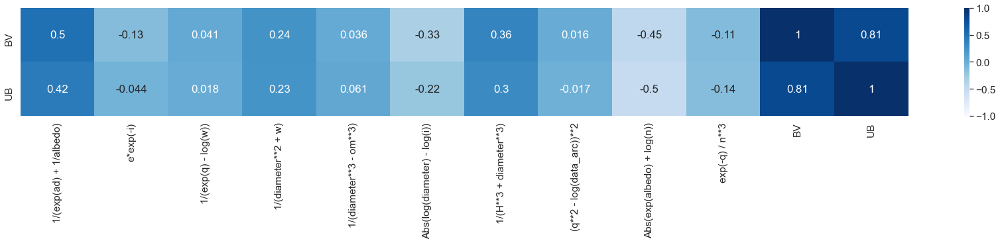

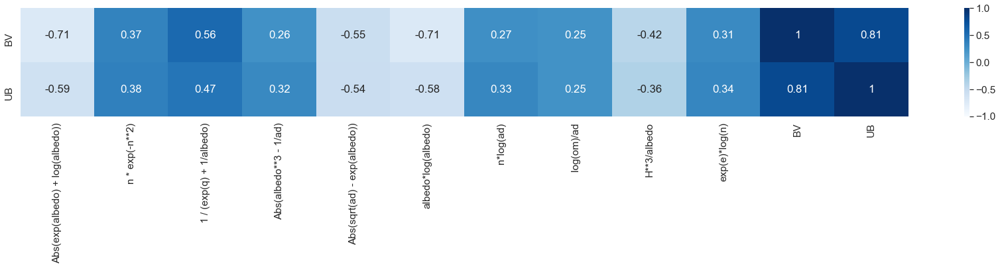

In [14]:
sns.set(font_scale=1.4)

corr = pd.concat([ considered_features.iloc[:, 0 : 10], for_feature_viz[['BV', 'UB']] ], axis = 1).corr().loc[['BV', 'UB'], :]
plt.subplots(figsize = (30, 3))
sns.heatmap(corr, vmin = -1, vmax = 1, cmap="Blues", annot=True)

corr = pd.concat([ considered_features.iloc[:, 10 : 20], for_feature_viz[['BV', 'UB']] ], axis = 1).corr().loc[['BV', 'UB'], :]
plt.subplots(figsize = (30, 3))
sns.heatmap(corr, vmin = -1, vmax = 1, cmap="Blues", annot=True)

corr = pd.concat([ considered_features.iloc[:, 20 : 30], for_feature_viz[['BV', 'UB']] ], axis = 1).corr().loc[['BV', 'UB'], :]
plt.subplots(figsize = (30, 3))
sns.heatmap(corr, vmin = -1, vmax = 1, cmap="Blues", annot=True)

corr = pd.concat([ considered_features.iloc[:, 30 : 40], for_feature_viz[['BV', 'UB']] ], axis = 1).corr().loc[['BV', 'UB'], :]
plt.subplots(figsize = (30, 3))
sns.heatmap(corr, vmin = -1, vmax = 1, cmap="Blues", annot=True)

sns.set(font_scale=1)

### Pipeline Function

In [15]:
def pipeline(X, test = False):
    X_copy = X.copy()
    
    # handle missing values
    if not test:
        imputer.fit_transform(X_copy)
    else: # test is True
        imputer.transform(X_copy)
        
    # These 'BV_estimate' and 'UB_estimate' are a work in progress
#     # Use gradientBoosting regressor to estimate the value of BV (Color index B-V magnitude difference)
#     X_copy['BV_estimate'] = model_BV.predict(feature_engineering_BV(X_copy))
    
#     # Use gradientBoosting regressor to estimate the value of UB (Color index U-B magnitude difference)
#     X_copy['UB_estimate'] = model_UB.predict(feature_engineering_UB(X_copy.drop('BV_estimate', axis = 1)))
    
    # Best features after feature selection
    X_copy['n*q'] = X_copy['n']*X_copy['q']
    X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
    X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
    X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
    #X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])

    
    # Drop Unwanted Original Features
    X_copy.drop(drop_original, axis = 'columns', inplace = True)
    
    
    # Standardize data
    if not test:
        ss.fit_transform(X_copy)
    else: # test == True
        ss.transform(X_copy)
     
        
        
    return X_copy



In [16]:
# Process Data
processed_X_train = pipeline(X_train)

## Inspection of Engineered Features
Features were selected by considering the plots in the following cells and the feature importances from ensemble methods. Features were removed from the pipeline function one by one until only the ones visualized below remained.

In [17]:
# Preliminaries for post feature engineering pair plot
processed_asteroids_train = pd.concat([processed_X_train, y_train.reset_index()['metallic']], axis = 1)


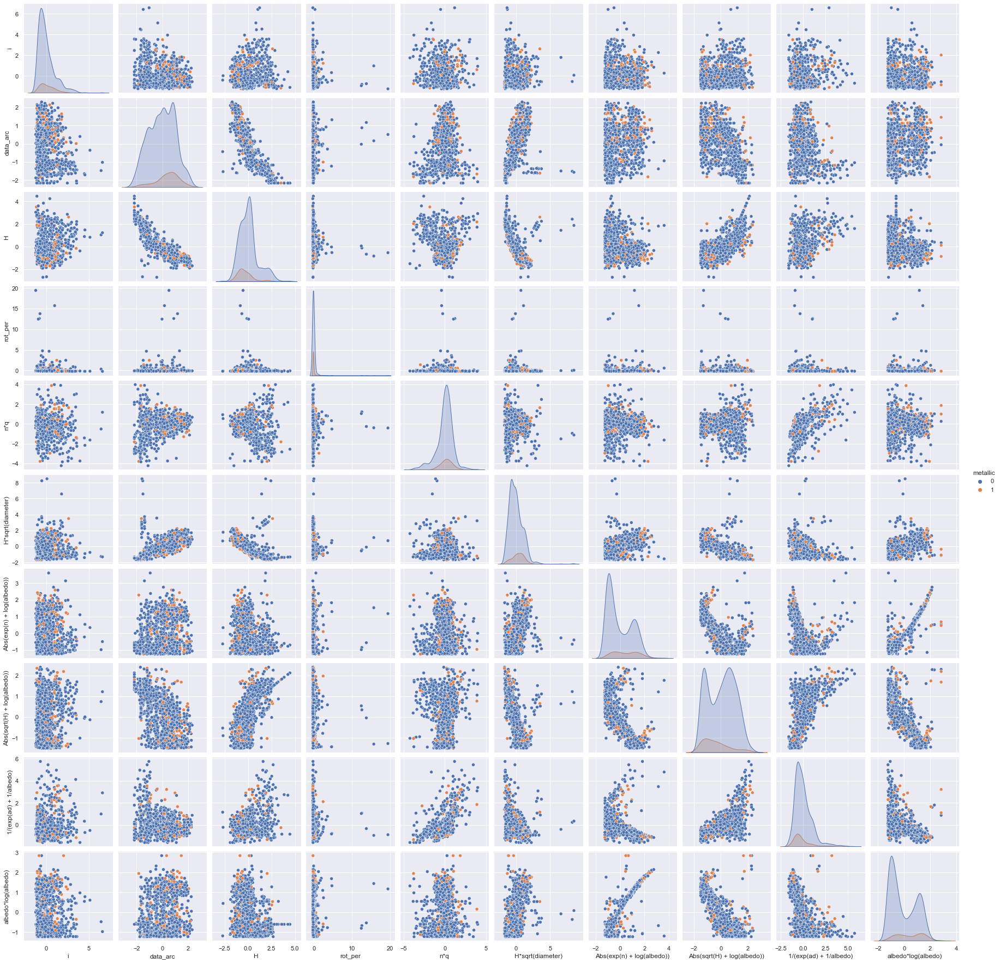

In [18]:
sns.pairplot(processed_asteroids_train, kind = 'scatter', hue = 'metallic')

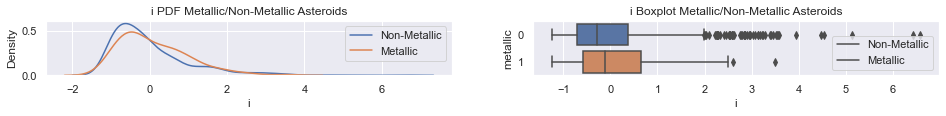

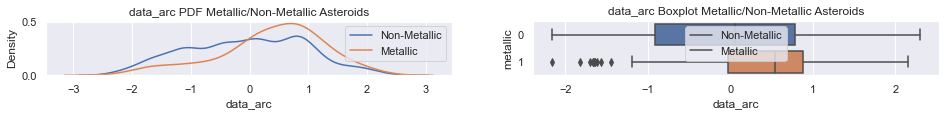

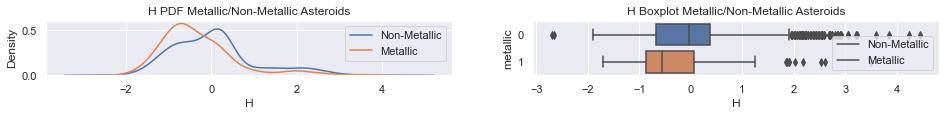

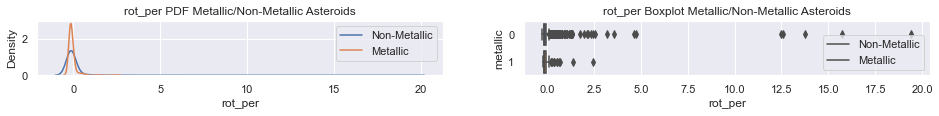

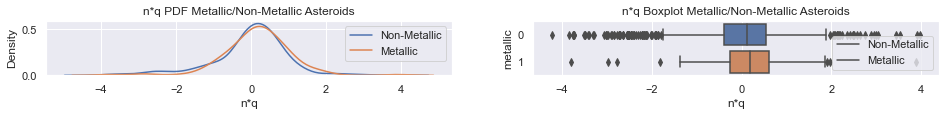

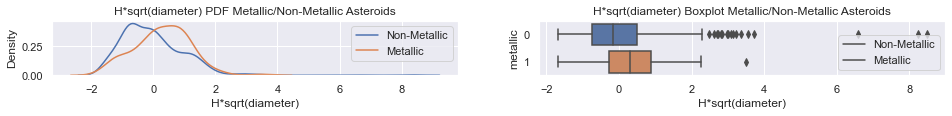

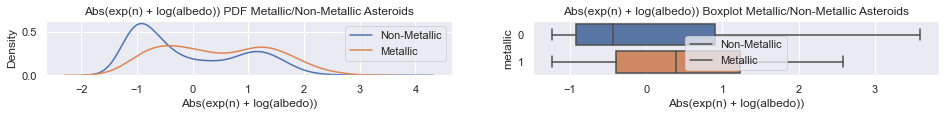

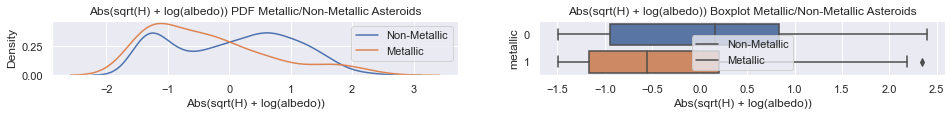

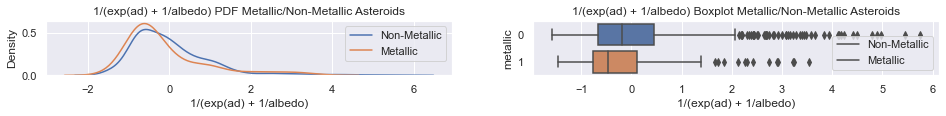

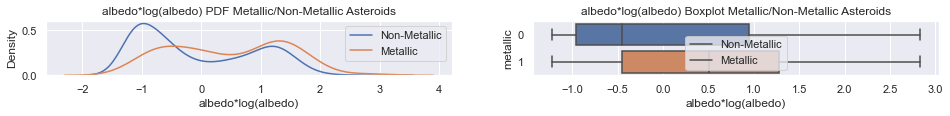

In [19]:
for col_name in processed_X_train.columns:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 1))
    sns.kdeplot(x = processed_asteroids_train[processed_asteroids_train['metallic'] == 0][col_name], ax=ax1)
    sns.kdeplot(x = processed_asteroids_train[processed_asteroids_train['metallic'] == 1][col_name], ax=ax1)
    ax1.legend(['Non-Metallic', 'Metallic'])
    ax1.set_title(col_name + ' PDF Metallic/Non-Metallic Asteroids')
    
    sns.boxplot(x = col_name, y = 'metallic', data = processed_asteroids_train, orient = 'h', ax=ax2)
    ax2.legend(['Non-Metallic', 'Metallic'])
    ax2.set_title(col_name + ' Boxplot Metallic/Non-Metallic Asteroids')

## Training and 10-Fold Cross Validation

In [20]:
def evaluate_model(model, X, y):
    
    # So that SMOTE over sampling is used wtih cross validation
    smote_model = imbpipeline(steps = [['smote', SMOTE(random_state = 0)],
                                        ['classifier', model]])
    
    # 10-Fold Cross Validation
    prediction_probs = cross_val_predict(smote_model, X, y, cv = 10, method = 'predict_proba')[:, 1]
    
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Plot ROC Curve
    fpr, tpr, thresholds_roc = roc_curve(y, prediction_probs)
    sns.lineplot(x = fpr, y = tpr, ax = ax1)
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_xlim([0, 1])
    ax1.set_ylim([0, 1])
    
    # Plot Precision-Recall Curve
    precision, recall, thresholds_prc = precision_recall_curve(y, prediction_probs)
    sns.lineplot(x = recall, y = precision, ax = ax2)
    ax2.set_xlabel('Recall')
    ax2.set_ylabel('Precision')
    ax2.set_xlim([0, 1])
    ax2.set_ylim([0, 1])
    
    fig.suptitle(str(model) + '  ROC and Precision-Recall Curves')
    plt.show()
    
    print("10-Fold Cross Validation ROC AUC Score: ", roc_auc_score(y, prediction_probs))
    print("10-Fold Cross Validation Precision-Recall AUC Score: ", auc(x = recall , y = precision))
    
    # return validation information
    labels = pd.DataFrame({'' : ['Thresholds_ROC', 'FPR', 'TPR', 'Thresholds_PRC', 'Precision', 'Recall']})
    val_stats = pd.DataFrame([thresholds_roc, fpr, tpr, thresholds_prc, precision, recall])
    return pd.concat([labels, val_stats], axis = 1).set_index('')

I use the SMOTE algorithm from the Imblearn package to oversample the metallic asteroids. In the original data set, non-metallic asteroids outnumbered metallic ones by nearly 9 to 1. Note that SMOTE is applied during the process of cross-validation, not before.

### K-Nearest Neighbors

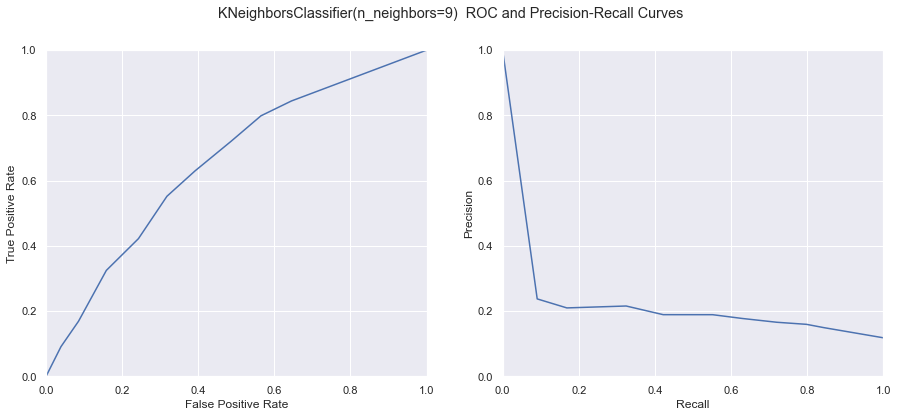

10-Fold Cross Validation ROC AUC Score:  0.6542645778938208
10-Fold Cross Validation Precision-Recall AUC Score:  0.22139458563961412


,0,1,2,3,4,5,6,7,8,9,10
,,,,,,,,,,,
Thresholds_ROC,2.000000,1.000000,0.888889,0.777778,0.666667,0.555556,0.444444,0.333333,0.222222,0.111111,0.0
FPR,0.000000,0.039164,0.085292,0.158399,0.242820,0.317668,0.391645,0.486510,0.564839,0.644909,1.0
TPR,0.000000,0.090909,0.168831,0.324675,0.422078,0.551948,0.629870,0.720779,0.798701,0.844156,1.0
Thresholds_PRC,0.000000,0.111111,0.222222,0.333333,0.444444,0.555556,0.666667,0.777778,0.888889,1.000000,NaN
Precision,0.118189,0.149254,0.159326,0.165672,0.177331,0.188889,0.188953,0.215517,0.209677,0.237288,1.0
Recall,1.000000,0.844156,0.798701,0.720779,0.629870,0.551948,0.422078,0.324675,0.168831,0.090909,0.0


In [21]:
knn = KNeighborsClassifier(9)
stats = evaluate_model(knn, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Logistic Regression

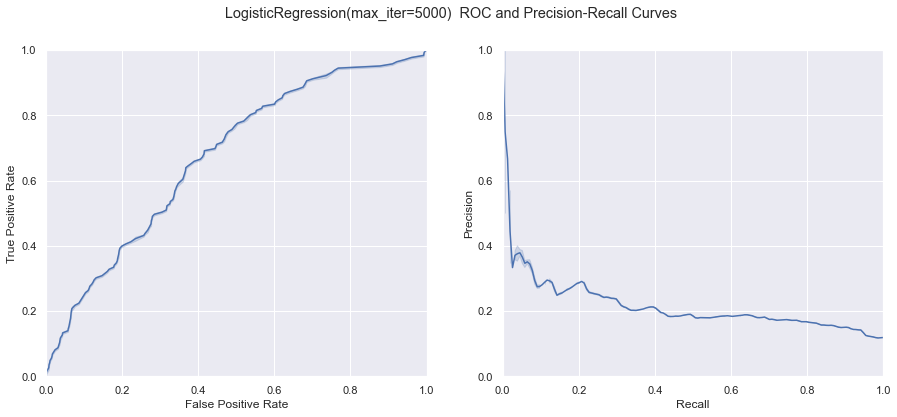

10-Fold Cross Validation ROC AUC Score:  0.673787483186961
10-Fold Cross Validation Precision-Recall AUC Score:  0.21741297263773798


0         1         2         3         4         5     \
                                                                             
Thresholds_ROC  1.985816  0.985816  0.984068  0.947464  0.827949  0.821278   
FPR             0.000000  0.000000  0.000870  0.000870  0.006963  0.006963   
TPR             0.000000  0.006494  0.006494  0.019481  0.019481  0.032468   
Thresholds_PRC  0.023743  0.023998  0.027984  0.030442  0.033708  0.033729   
Precision       0.118827  0.118147  0.117465  0.117556  0.117647  0.116964   
Recall          1.000000  0.993506  0.987013  0.987013  0.987013  0.980519   

                    6         7         8         9         10        11    \
                                                                             
Thresholds_ROC  0.819106  0.814671  0.807915  0.804019  0.803211  0.797810   
FPR             0.007833  0.007833  0.009574  0.009574  0.010444  0.010444   
TPR             0.032468  0.038961  0.038961  0.045455  0.045455  0.051948   
Thresholds_PRC  0.044482  0.045457  0.052504  0.052626  0.055865  0.055940   
Precision       0.117054  0.117145  0.117236  0.117327  0.117418  0.117510   
Recall          0.980519  0.980519  0.980519  0.980519  0.980519  0.980519   

                    12        13        14        15        16        17    \
                                                                             
Thresholds_ROC  0.783648  0.781660  0.777968  0.773998  0.771115  0.770898   
FPR             0.013925  0.013925  0.015666  0.015666  0.016536  0.016536   
TPR             0.051948  0.058442  0.058442  0.064935  0.064935  0.071429   
Thresholds_PRC  0.059768  0.060922  0.065687  0.065736  0.067655  0.067966   
Precision       0.117601  0.117693  0.117785  0.117877  0.117969  0.118061   
Recall          0.980519  0.980519  0.980519  0.980519  0.980519  0.980519   

                    18        19        20        21        22        23    \
                                                                             
Thresholds_ROC  0.757005  0.756074  0.750302  0.746823  0.740322  0.739603   
FPR             0.020017  0.020017  0.023499  0.023499  0.031332  0.031332   
TPR             0.071429  0.077922  0.077922  0.084416  0.084416  0.090909   
Thresholds_PRC  0.068854  0.069784  0.069913  0.072240  0.072811  0.078971   
Precision       0.118153  0.118246  0.118339  0.118431  0.118524  0.118617   
Recall          0.980519  0.980519  0.980519  0.980519  0.980519  0.980519   

                    24        25        26        27        28        29    \
                                                                             
Thresholds_ROC  0.738523  0.738337  0.736709  0.733788  0.732090  0.731737   
FPR             0.033072  0.033072  0.035683  0.035683  0.037424  0.037424   
TPR             0.090909  0.097403  0.097403  0.110390  0.110390  0.123377   
Thresholds_PRC  0.079721  0.081170  0.083874  0.084899  0.086743  0.090964   
Precision       0.118711  0.118804  0.118898  0.118991  0.119085  0.119179   
Recall          0.980519  0.980519  0.980519  0.980519  0.980519  0.980519   

                    30        31        32        33        34        35    \
                                                                             
Thresholds_ROC  0.726434  0.726359  0.726249  0.725788  0.709488  0.709368   
FPR             0.042646  0.042646  0.043516  0.043516  0.057441  0.057441   
TPR             0.123377  0.129870  0.129870  0.136364  0.136364  0.142857   
Thresholds_PRC  0.091553  0.093403  0.094392  0.095199  0.095804  0.099554   
Precision       0.119273  0.119368  0.119462  0.119557  0.119651  0.119746   
Recall          0.980519  0.980519  0.980519  0.980519  0.980519  0.980519   

                    36        37        38        39        40        41    \
                                                                             
Thresholds_ROC  0.708818  0.707809  0.707246  0.706441  0.705596  0.704857   
FPR             0.058312  0.058312  

In [22]:
log_reg = LogisticRegression(max_iter = 5000)
stats = evaluate_model(log_reg, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Random Forest

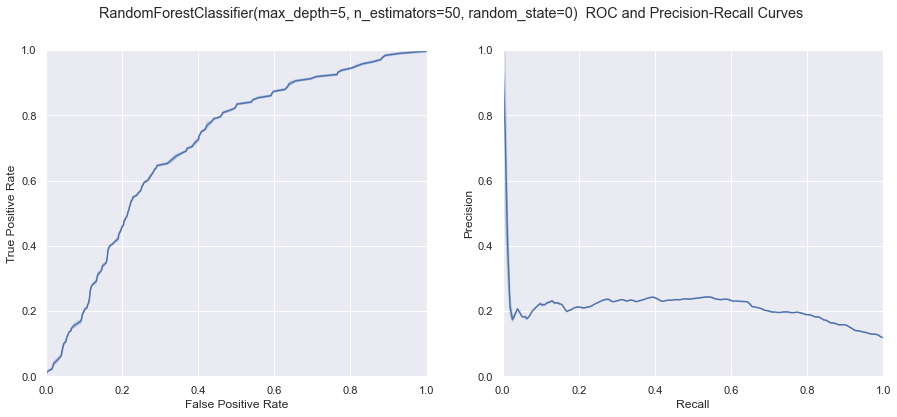

10-Fold Cross Validation ROC AUC Score:  0.7106716173295807
10-Fold Cross Validation Precision-Recall AUC Score:  0.21486387485441735


0         1         2         3         4         5     \
                                                                             
Thresholds_ROC  1.758450  0.758450  0.751343  0.742401  0.735324  0.733870   
FPR             0.000000  0.000000  0.000870  0.000870  0.005222  0.005222   
TPR             0.000000  0.006494  0.006494  0.012987  0.012987  0.019481   
Thresholds_PRC  0.015956  0.016883  0.017866  0.018708  0.019780  0.020000   
Precision       0.118189  0.117512  0.117602  0.117692  0.117783  0.117874   
Recall          1.000000  0.993506  0.993506  0.993506  0.993506  0.993506   

                    6         7         8         9         10        11    \
                                                                             
Thresholds_ROC  0.725390  0.724395  0.723399  0.723197  0.721220  0.720442   
FPR             0.015666  0.015666  0.017406  0.017406  0.020017  0.020017   
TPR             0.019481  0.025974  0.025974  0.032468  0.032468  0.045455   
Thresholds_PRC  0.020499  0.021655  0.021898  0.021947  0.022144  0.023165   
Precision       0.117965  0.118056  0.118147  0.118238  0.118329  0.118421   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    12        13        14        15        16        17    \
                                                                             
Thresholds_ROC  0.715802  0.715277  0.711076  0.710855  0.709937  0.709416   
FPR             0.031332  0.031332  0.039164  0.039164  0.041775  0.041775   
TPR             0.045455  0.058442  0.058442  0.064935  0.064935  0.084416   
Thresholds_PRC  0.023281  0.023423  0.024216  0.024874  0.025177  0.025813   
Precision       0.118513  0.118605  0.118697  0.118789  0.118881  0.118974   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    18        19        20        21        22        23    \
                                                                             
Thresholds_ROC  0.709132  0.707066  0.706177  0.705746  0.703434  0.703178   
FPR             0.044386  0.044386  0.046997  0.046997  0.052219  0.052219   
TPR             0.084416  0.097403  0.097403  0.103896  0.103896  0.110390   
Thresholds_PRC  0.025862  0.025914  0.026532  0.026636  0.027237  0.027299   
Precision       0.119066  0.119159  0.119252  0.119345  0.119438  0.119531   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    24        25        26        27        28        29    \
                                                                             
Thresholds_ROC  0.703156  0.702815  0.702205  0.701993  0.701071  0.700754   
FPR             0.053090  0.053090  0.054830  0.054830  0.057441  0.057441   
TPR             0.110390  0.116883  0.116883  0.123377  0.123377  0.129870   
Thresholds_PRC  0.027429  0.027565  0.027714  0.028562  0.029224  0.029940   
Precision       0.119625  0.119718  0.119812  0.119906  0.120000  0.120094   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    30        31        32        33        34        35    \
                                                                             
Thresholds_ROC  0.700069  0.699849  0.699041  0.698486  0.698389  0.697876   
FPR             0.058312  0.060923  0.065274  0.065274  0.066144  0.066144   
TPR             0.129870  0.136364  0.136364  0.142857  0.142857  0.149351   
Thresholds_PRC  0.030479  0.030913  0.031098  0.032384  0.033036  0.033678   
Precision       0.120189  0.120283  0.120378  0.120472  0.120567  0.120662   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    36        37        38        39        40        41    \
                                                                             
Thresholds_ROC  0.693142  0.692347  0.685793  0.684742  0.683715  0.683530   
FPR             0.073977  0.073977  

In [23]:
rfc = RandomForestClassifier(n_estimators = 50, max_depth = 5, random_state = 0)
stats = evaluate_model(rfc, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Gradient Boosting

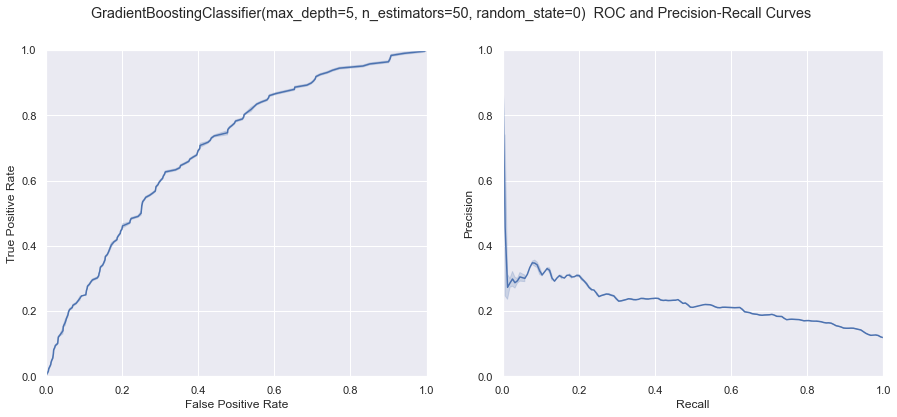

10-Fold Cross Validation ROC AUC Score:  0.6989703073253987
10-Fold Cross Validation Precision-Recall AUC Score:  0.22788303622323913


0         1         2         3         4         5     \
                                                                             
Thresholds_ROC  1.895885  0.895885  0.881342  0.874754  0.869788  0.867475   
FPR             0.000000  0.000000  0.003481  0.003481  0.006092  0.006092   
TPR             0.000000  0.006494  0.006494  0.012987  0.012987  0.019481   
Thresholds_PRC  0.014172  0.015018  0.015164  0.015442  0.015896  0.016510   
Precision       0.118736  0.118056  0.118147  0.118238  0.118329  0.118421   
Recall          1.000000  0.993506  0.993506  0.993506  0.993506  0.993506   

                    6         7         8         9         10        11    \
                                                                             
Thresholds_ROC  0.864951  0.862825  0.857599  0.855374  0.851536  0.850472   
FPR             0.006963  0.006963  0.009574  0.009574  0.012185  0.012185   
TPR             0.019481  0.025974  0.025974  0.032468  0.032468  0.038961   
Thresholds_PRC  0.017067  0.017226  0.017327  0.018045  0.018168  0.018412   
Precision       0.118513  0.118605  0.118697  0.118789  0.118881  0.118974   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    12        13        14        15        16        17    \
                                                                             
Thresholds_ROC  0.850443  0.850279  0.845802  0.840019  0.838037  0.837115   
FPR             0.013055  0.013055  0.014795  0.014795  0.017406  0.017406   
TPR             0.038961  0.045455  0.045455  0.051948  0.051948  0.058442   
Thresholds_PRC  0.018479  0.018801  0.018972  0.019152  0.019178  0.019500   
Precision       0.119066  0.119159  0.119252  0.119345  0.119438  0.119531   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    18        19        20        21        22        23    \
                                                                             
Thresholds_ROC  0.835212  0.829945  0.826998  0.826759  0.821169  0.819257   
FPR             0.019147  0.019147  0.020017  0.020017  0.022628  0.022628   
TPR             0.058442  0.077922  0.077922  0.084416  0.084416  0.090909   
Thresholds_PRC  0.019755  0.019950  0.019964  0.019996  0.020003  0.020116   
Precision       0.119625  0.119718  0.119812  0.119906  0.120000  0.120094   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    24        25        26        27        28        29    \
                                                                             
Thresholds_ROC  0.815060  0.814001  0.804522  0.803172  0.802871  0.799554   
FPR             0.024369  0.024369  0.030461  0.030461  0.031332  0.031332   
TPR             0.090909  0.097403  0.097403  0.103896  0.103896  0.116883   
Thresholds_PRC  0.020148  0.020180  0.020362  0.020373  0.020404  0.020638   
Precision       0.120189  0.120283  0.120378  0.120472  0.120567  0.120662   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    30        31        32        33        34        35    \
                                                                             
Thresholds_ROC  0.798708  0.796369  0.792461  0.789785  0.782350  0.778748   
FPR             0.032202  0.032202  0.036554  0.036554  0.044386  0.044386   
TPR             0.116883  0.123377  0.123377  0.129870  0.129870  0.149351   
Thresholds_PRC  0.020645  0.020876  0.020877  0.020944  0.020971  0.020975   
Precision       0.120758  0.120853  0.120949  0.121044  0.121140  0.121236   
Recall          0.993506  0.993506  0.993506  0.993506  0.993506  0.993506   

                    36        37        38        39        40        41    \
                                                                             
Thresholds_ROC  0.778329  0.777381  0.762720  0.756488  0.753278  0.752473   
FPR             0.045257  0.045257  

In [24]:
gbc = GradientBoostingClassifier(n_estimators = 50, max_depth = 5, random_state = 0)
stats = evaluate_model(gbc, processed_X_train, y_train)

with pd.option_context('display.max_rows', 10, 'display.max_columns', None): 
    display(stats)

### Training the Models on Entire Training Set

In [25]:
# Use SMOTE to resample the training set. Recall that we did this previously for cross-validation, but not the actual X_train
os = SMOTE(random_state = 0)
os_processed_X_train, os_y_train = os.fit_resample(processed_X_train, y_train)

knn.fit(os_processed_X_train, os_y_train)
log_reg.fit(os_processed_X_train, os_y_train)
rfc.fit(os_processed_X_train, os_y_train)
gbc.fit(os_processed_X_train, os_y_train)

GradientBoostingClassifier(max_depth=5, n_estimators=50, random_state=0)

### Feature Importance (Random Forest and Gradient Boosting Classifier)

In [26]:
feature_importances = dict(zip(processed_X_train.columns, zip(rfc.feature_importances_ , gbc.feature_importances_)))
feature_importances[''] = ('Random Forest', 'Gradient Boosting')
pd.DataFrame(feature_importances).set_index('')

,i,data_arc,H,rot_per,n*q,H*sqrt(diameter),Abs(exp(n) + log(albedo)),Abs(sqrt(H) + log(albedo)),1/(exp(ad) + 1/albedo),albedo*log(albedo)
,,,,,,,,,,
Random Forest,0.054462,0.119529,0.095897,0.058188,0.084336,0.063245,0.161220,0.096643,0.088003,0.178478
Gradient Boosting,0.086423,0.114516,0.082267,0.080690,0.093729,0.059307,0.123009,0.074444,0.118727,0.166888


## Test Set ROC and Precision-Recall Assessment

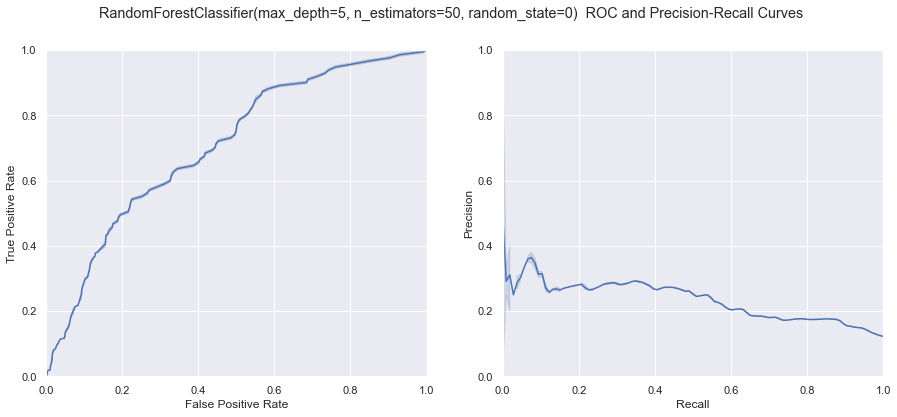

Test Set ROC AUC Score:  0.7057381705028153
Test Set Precision-Recall AUC Score:  0.23206245189318267


In [27]:
X_test, y_test = asteroids_test.drop('metallic', axis=1), asteroids_test['metallic']

# Reset Indices
X_test = X_test.reset_index().drop('index', axis=1)
y_test = pd.DataFrame(y_test).reset_index().drop('index', axis=1)['metallic']

# Process the test set
processed_X_test = pipeline(X_test, test = True)

best_model = rfc
prediction_probs = best_model.predict_proba(processed_X_test)[:, 1]


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
# Plot ROC Curve
fpr, tpr, thresholds_roc = roc_curve(y_test, prediction_probs)
sns.lineplot(x = fpr, y = tpr, ax = ax1)
ax1.set_xlabel('False Positive Rate')
ax1.set_ylabel('True Positive Rate')
ax1.set_xlim([0, 1])
ax1.set_ylim([0, 1])

# Plot Precision-Recall Curve
precision, recall, thresholds_prc = precision_recall_curve(y_test, prediction_probs)
sns.lineplot(x = recall, y = precision, ax = ax2)
ax2.set_xlabel('Recall')
ax2.set_ylabel('Precision')
ax2.set_xlim([0, 1])
ax2.set_ylim([0, 1])

fig.suptitle(str(best_model) + '  ROC and Precision-Recall Curves')
plt.show()

print("Test Set ROC AUC Score: ", roc_auc_score(y_test, prediction_probs))
print("Test Set Precision-Recall AUC Score: ", auc(x = recall , y = precision))

### Final Remarks

My hope was that I'd get at least 75% area under the ROC. While I didn't manage to achieve that, 70% is still decent improvement over nothing. The entire reason I choose to optimize for AUC is because I knew that the ideal balance between each of the standard classification metrics is going to depend on the situation.

Given the shape of the ROC / precision-recall curves, there are a few cases where different thresholds might be ideal. We might want to have a fairly high recall if we have a longer amount of time / resources to search for high value metallic asteroids. Alternatively, if we have very little time / resources, then it might be better to reduce recall for greater precision. Lastly, since we already have a lot of asteroid data without the proper classifications, we could use the model to predict the probabilities of each of those asteroids being metallic and then verify in order of highest to lowest probability. 

<br/><br/><br/>

## Below is Work In Progress. Please Ignore

In [28]:
#asteroids_BV = asteroids.drop(cleaned_asteroids.index, axis = 'rows')

asteroids_BV = asteroids.drop(asteroids_test.index, axis = 'rows')
asteroids_BV = asteroids_BV[~asteroids_BV['BV'].isna()]
asteroids_BV = asteroids_BV[['BV', 'e', 'i', 'om', 'w', 'q', 'ad', 'data_arc', 'H', 'diameter', 'albedo', 'rot_per', 'n']] 
asteroids_BV['diameter'] = pd.to_numeric(asteroids_BV['diameter'], errors='coerce')

In [29]:
X_train_BV, X_test_BV, y_train_BV, y_test_BV = train_test_split(
    asteroids_BV.drop('BV', axis = 1), 
    asteroids_BV['BV'], 
    test_size = 0.25, 
    random_state = 0
)

In [30]:
imputer_BV = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer_BV.fit(X_train_BV)

KNNImputer(add_indicator=True, copy=False)

In [31]:
def feature_engineering_BV(X):
    X_copy = X.copy()
    
    X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo']) 
    X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
    X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
    X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
    X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
    X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
    X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
    X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    
    
    X_copy.drop(['i', 'e', 'om', 'w', 'data_arc', 'H', 'rot_per', 'n', 'diameter'], axis = 'columns', inplace = True)
    
    return X_copy

In [32]:
imputer_BV.transform(X_train_BV)

processed_X_train_BV = feature_engineering_BV(X_train_BV)

model_BV = GradientBoostingRegressor(n_estimators = 10, max_depth = 2, random_state = 0).fit(processed_X_train_BV, y_train_BV)
train_predictions_BV = model_BV.predict(processed_X_train_BV)

print('Train MAE: ', mean_absolute_error(y_train_BV, train_predictions_BV))
print('Train MSE: ', mean_squared_error(y_train_BV, train_predictions_BV))

Train MAE:  0.05015703541408467
Train MSE:  0.00383658032809479


In [33]:
imputer_BV.transform(X_test_BV)

processed_X_test_BV = feature_engineering_BV(X_test_BV)

test_predictions_BV = model_BV.predict(processed_X_test_BV)

print('Test MAE: ', mean_absolute_error(y_test_BV, test_predictions_BV))
print('Test MSE: ', mean_squared_error(y_test_BV, test_predictions_BV))

Test MAE:  0.05080120939896022
Test MSE:  0.004263913958225345


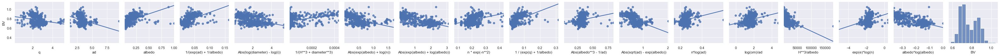

In [34]:
sns.pairplot(pd.concat([processed_X_train_BV, 
                        y_train_BV,
                       ], axis = 1),
             y_vars=['BV'],
             kind = 'reg',
             plot_kws = {'ci':None}
            )

In [35]:
#asteroids_UB = asteroids.drop(cleaned_asteroids.index, axis = 'rows')

asteroids_UB = asteroids.drop(asteroids_test.index, axis = 'rows')
asteroids_UB = asteroids_UB[~asteroids_UB['UB'].isna()]
asteroids_UB = asteroids_UB[['UB', 'e', 'i', 'om', 'w', 'q', 'ad', 'data_arc', 'H', 'diameter', 'albedo', 'rot_per', 'n']]  
asteroids_UB['diameter'] = pd.to_numeric(asteroids_UB['diameter'], errors='coerce')

In [36]:
X_train_UB, X_test_UB, y_train_UB, y_test_UB = train_test_split(
    asteroids_UB.drop('UB', axis = 1), 
    asteroids_UB['UB'], 
    test_size = 0.25, 
    random_state = 0
)

In [37]:
imputer_UB = KNNImputer(n_neighbors = 5, weights="uniform", copy = False, add_indicator = True)
imputer_UB.fit(X_train_UB)

KNNImputer(add_indicator=True, copy=False)

In [38]:
def feature_engineering_UB(X):
    X_copy = X.copy()
    
    X_copy['n*q'] = X_copy['n']*X_copy['q']
#     X_copy['H*sqrt(diameter)'] = X_copy['H']*np.sqrt(X_copy['diameter'])
#     X_copy['Abs(albedo - sqrt(e))'] = abs(X_copy['albedo'] - np.sqrt(X_copy['e']))
#     X_copy['Abs(exp(n) + log(albedo))'] = abs(np.exp(X_copy['n']) + np.log(X_copy['albedo']))
#     X_copy['Abs(sqrt(H) + log(albedo))'] = abs(np.sqrt(X_copy['H']) + np.log(X_copy['albedo']))
#     X_copy['1/(exp(ad) + 1/albedo)'] = 1/(np.exp(X_copy['ad']) + 1/X_copy['albedo'])
#     X_copy['1/(diameter**2 + w)'] = 1/(X_copy['diameter']**2 + X_copy['w']) 
#     X_copy['Abs(log(diameter) - log(i))'] = abs(np.log(X_copy['diameter']) - np.log(X_copy['i']))
#     X_copy['1/(H**3 + diameter**3)'] = 1/(X_copy['H']**3 + X_copy['diameter']**3)
    X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
#     X_copy['Abs(exp(albedo) + log(albedo))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['albedo']))
#     X_copy['Abs(exp(albedo) + log(n))'] = abs(np.exp(X_copy['albedo']) + np.log(X_copy['n']))
#     X_copy['n * exp(-n**2)'] = X_copy['n'] * np.exp(-X_copy['n']**2)
#     X_copy['1 / (exp(q) + 1/albedo)'] =1 / (np.exp(X_copy['q']) + 1/X_copy['albedo'])
#     X_copy['Abs(albedo**3 - 1/ad)'] = abs(X_copy['albedo']**3 - 1/X_copy['ad'])
#     X_copy['Abs(sqrt(ad) - exp(albedo))'] = abs(np.sqrt(X_copy['ad']) - np.exp(X_copy['albedo']))
#     X_copy['albedo*log(albedo)'] = X_copy['albedo'] * np.log(X_copy['albedo'])
    X_copy['n*log(ad)'] = X_copy['n'] * np.log(X_copy['ad'])
    X_copy['log(om)/ad'] = np.log(X_copy['om']) / X_copy['ad']
#     X_copy['H**3/albedo'] = X_copy['H']**3 / X_copy['albedo']
    X_copy['exp(e)*log(n)'] = np.exp(X_copy['e']) * np.log(X_copy['n'])
    
    
    X_copy.drop(['e', 'om', 'w', 'data_arc', 'H', 'rot_per', 'n', 'albedo'], axis = 'columns', inplace = True)
    
    return X_copy

In [39]:
imputer_UB.transform(X_train_UB)

processed_X_train_UB = feature_engineering_UB(X_train_UB)

model_UB = GradientBoostingRegressor(n_estimators = 10, max_depth = 2, random_state = 0).fit(processed_X_train_UB, y_train_UB)
train_predictions_UB = model_UB.predict(processed_X_train_UB)

print('Train MAE: ', mean_absolute_error(y_train_UB, train_predictions_UB))
print('Train MSE: ', mean_squared_error(y_train_UB, train_predictions_UB))

Train MAE:  0.06601654267256404
Train MSE:  0.006376928219439889


In [40]:
imputer_UB.transform(X_test_UB)

processed_X_test_UB = feature_engineering_UB(X_test_UB)

test_predictions_UB = model_UB.predict(processed_X_test_UB)

print('Test MAE: ', mean_absolute_error(y_test_UB, test_predictions_UB))
print('Test MSE: ', mean_squared_error(y_test_UB, test_predictions_UB))


Test MAE:  0.0651381182665339
Test MSE:  0.006325883528280295


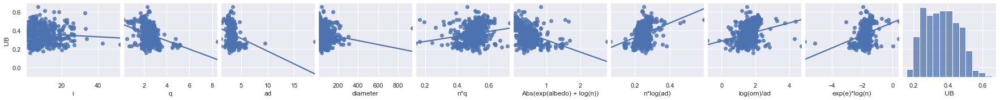

In [41]:
sns.pairplot(pd.concat([processed_X_train_UB, 
                        y_train_UB,
                       ], axis = 1),
             y_vars=['UB'],
             kind = 'reg',
             plot_kws = {'ci':None}
            )